<a href="https://colab.research.google.com/github/garylau1/model_training/blob/main/personal_project_animal_with_different_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Personal project about image classification
####Introduction:
This is our classification task in the animals.We use transfer learning and non-tranfer learning CNN model to train our model.

We have 6 types of animals 'butterflies',
'chickens','elephants','horses','spiders' and 'squirells'. This model will identities the class of the image which belongs to.

We also explore different way to import image into colab.

We try different  models and different amount of the data in our dataset(which I create in other file) and different epoches to see which one has the best perforamance.

#### Highlight part:
We create our own training,testing loop and custome dataset. We combine dataset using torchvision dataset function.

We explore and plot the images as well.

We also split the whole dataset and save into github in other files(the one with 40% of data and the one with full set of data)

We also find out the dataset provided have repeated images.


####Result :
We get very high accuracy after using transfer learning for all three transfer learning models.(test accuracy around 96%) However the system crashs when we use CNN model from scatch(test accuacy around 75% ). We plot the result in the tensorboard.
It it surprising that we get slightly better accuracy with 40% of the whole dataset.

The training loops and some helper functions are from the website: https://github.com/mrdbourke/pytorch-deep-learning/tree/main/going_modular


#### Future work:
Try more differet models.


In [ ]:
# Import torch
import torch
from torch import nn

# Exercises require PyTorch > 1.10.0
print(torch.__version__)

# Setup device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

import os

from pathlib import Path
import requests
import zipfile

data_path=Path(Path("data_set100%"))
data_path2=Path(Path("data_set40%"))


2.3.1+cu121


In [ ]:
import requests

def make_data(data_path,des_location):

  data_path=Path(data_path)

  if not data_path.is_dir():

    data_path.mkdir(parents=True,exist_ok=True)
    target_name=data_path.name
    with open (data_path/target_name,"wb") as f:
        request=requests.get(des_location)
        f.write(request.content)

    with zipfile.ZipFile(data_path/target_name,"r") as w:
      w.extractall(data_path)

    os.remove(data_path/target_name)







In [ ]:
make_data(data_path,"https://github.com/garylau1/model_training/raw/main/our_file1.0.zip")
make_data(data_path2,"https://github.com/garylau1/model_training/raw/main/our_file0.4.zip")

In [ ]:
# 2. Become one with the data
import os
def walk_through_dir(dir_path):
  """Walks through dir_path returning file counts of its contents."""
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")

In [ ]:
# Setup train and testing paths
train_paths=data_path/"train"
test_paths=data_path/"test"
val_paths=data_path/"validation"
whole_paths=data_path

list_path=list(whole_paths.glob("*/*/*.jpeg"))
walk_through_dir(whole_paths)

There are 2 directories and 0 images in 'data_set100%'.
There are 6 directories and 0 images in 'data_set100%/test'.
There are 0 directories and 455 images in 'data_set100%/test/spiders'.
There are 0 directories and 202 images in 'data_set100%/test/butterflies'.
There are 0 directories and 314 images in 'data_set100%/test/horses'.
There are 0 directories and 365 images in 'data_set100%/test/chickens'.
There are 0 directories and 211 images in 'data_set100%/test/squirells'.
There are 0 directories and 105 images in 'data_set100%/test/elephants'.
There are 6 directories and 0 images in 'data_set100%/train'.
There are 0 directories and 4267 images in 'data_set100%/train/spiders'.
There are 0 directories and 1789 images in 'data_set100%/train/butterflies'.
There are 0 directories and 2431 images in 'data_set100%/train/horses'.
There are 0 directories and 3306 images in 'data_set100%/train/chickens'.
There are 0 directories and 1802 images in 'data_set100%/train/squirells'.
There are 0 dire

In [ ]:
list_path2=list(data_path2.glob("*/*/*.jpeg"))
len(list_path2)

train_paths2=data_path2/"train"
test_paths2=data_path2/"test"
val_paths2=data_path2/"validation"

In [ ]:
len(list_path)

16258

243 300


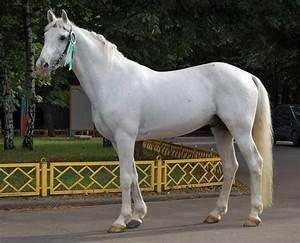

In [ ]:
# Do the image visualization with matplotlib

import random
from PIL import Image

radom_path=random.choice(list_path)
radom_path.parent.stem

img=Image.open(radom_path)



print(img.height,img.width)

img

We've got some images in our folders.

Now we need to make them compatible with PyTorch by:
1. Transform the data into tensors.
2. Turn the tensor data into a `torch.utils.data.Dataset` and later a `torch.utils.data.DataLoader`.

In [ ]:
# 3.1 Transforming data with torchvision.transforms
import torch
from torch.utils.data import DataLoader
from torchvision import datasets,transforms

In [ ]:
# Write a function to plot transformed images
import matplotlib.pyplot as plt


def plot_image(image_path_list,transform,n=3):
  random_path=random.sample(image_path_list,k=3)

  for i in random_path:
    fig,ax=plt.subplots(1,2)
    img=Image.open(i)
    ax[0].imshow(img)

    transform_img=transform(img)
    ax[0].set_title(f"shape{img.height,img.width}")
    ax[0].axis("off")
    ax[1].imshow(transform_img.permute(1,2,0))
    ax[1].set_title(f"shape{transform_img.permute(1,2,0).shape}")
    ax[1].axis("off")






In [ ]:

device= "cuda" if torch.cuda.is_available() else "cpu"


def create_b0():
  import torch

  import torchvision
  from torch import nn

  weightsz=torchvision.models.EfficientNet_B0_Weights.DEFAULT
  model_z=torchvision.models.efficientnet_b0(weights=weightsz).to(device)

  for param in model_z.features.parameters():
      param.requires_grad = False

  model_z.classifier=torch.nn.Sequential(
      torch.nn.Dropout(p=0.3, inplace=True),
      torch.nn.Linear(in_features=1280,
                      out_features=6, # same number of output units as our number of classes
                      bias=True)).to(device)
  model_z.name="effectiveb0"

  return model_z
import torchvision

data_transformz=torchvision.models.EfficientNet_B0_Weights.DEFAULT.transforms()


In [ ]:
try:
  import torchinfo
except:
  ! pip install torchinfo
  import torchinfo

from torchinfo import summary

model_z=create_b0()
summary(model_z,input_size=[1,3,200,200],verbose=0)


Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [1, 6]                    --
├─Sequential: 1-1                                       [1, 1280, 7, 7]           --
│    └─Conv2dNormActivation: 2-1                        [1, 32, 100, 100]         --
│    │    └─Conv2d: 3-1                                 [1, 32, 100, 100]         (864)
│    │    └─BatchNorm2d: 3-2                            [1, 32, 100, 100]         (64)
│    │    └─SiLU: 3-3                                   [1, 32, 100, 100]         --
│    └─Sequential: 2-2                                  [1, 16, 100, 100]         --
│    │    └─MBConv: 3-4                                 [1, 16, 100, 100]         (1,448)
│    └─Sequential: 2-3                                  [1, 24, 50, 50]           --
│    │    └─MBConv: 3-5                                 [1, 24, 50, 50]           (6,004)
│    │    └─MBConv: 3-6                      

In [ ]:

def create_b2():
  import torch

  import torchvision

  from torch import nn


  weights=torchvision.models.EfficientNet_B2_Weights.DEFAULT
  model_0=torchvision.models.efficientnet_b2(weights=weights).to(device)

  for param in model_0.features.parameters():
      param.requires_grad = False

  model_0.classifier=torch.nn.Sequential(
      torch.nn.Dropout(p=0.3, inplace=True),
      torch.nn.Linear(in_features=1408,
                      out_features=6, # same number of output units as our number of classes
                      bias=True)).to(device)
  model_0.name="effectiveb2"

  return model_0
import torchvision
data_transform=torchvision.models.EfficientNet_B2_Weights.DEFAULT.transforms()


#plot_image(list_path,data_transform,n=3)



In [ ]:
try:
  import torchinfo
except:
  ! pip install torchinfo
  import torchinfo

from torchinfo import summary
model_0=create_b2()

summary(model_0,input_size=[1,3,200,200],verbose=0)
#summary(model_0,input_size=[1,3,200,200],verbose=0,row_settings=["var_names"])

Layer (type:depth-idx)                                  Output Shape              Param #
EfficientNet                                            [1, 6]                    --
├─Sequential: 1-1                                       [1, 1408, 7, 7]           --
│    └─Conv2dNormActivation: 2-1                        [1, 32, 100, 100]         --
│    │    └─Conv2d: 3-1                                 [1, 32, 100, 100]         (864)
│    │    └─BatchNorm2d: 3-2                            [1, 32, 100, 100]         (64)
│    │    └─SiLU: 3-3                                   [1, 32, 100, 100]         --
│    └─Sequential: 2-2                                  [1, 16, 100, 100]         --
│    │    └─MBConv: 3-4                                 [1, 16, 100, 100]         (1,448)
│    │    └─MBConv: 3-5                                 [1, 16, 100, 100]         (612)
│    └─Sequential: 2-3                                  [1, 24, 50, 50]           --
│    │    └─MBConv: 3-6                        

### Load image data using `ImageFolder`

In [ ]:

from torch.utils.data import Dataset
from torchvision import datasets,transforms
import random
from PIL import Image

def data_creator(train_path=train_paths,test_path=test_paths,val_path=None,transform1=data_transform,batch_size=32,num_worker=os.cpu_count()):
  class customdata(Dataset):
    def __init__(self,paths,transform=transform1):
      self.list_file=sorted(list(paths.glob("*/*.jpeg")))
      self.transform=transform
      self.paths=paths


      self.class_names=sorted([i.name for i in list (os.scandir(paths))])
      self.class_toidx=self.class_to_idx()
    def __len__(self):
      return len(list(self.list_file))

    def print_image(self,index):
      img=Image.open(self.list_file[index])

      return img

    def class_to_idx(self):
      classes=self.class_names

      return { classes[i]: i for i in range(len(classes))}


    def __getitem__(self,index):
      image1=self.print_image(index)

      indexes=self.class_to_idx()

      name_withindex=self.list_file[index].parent.stem




      index1=indexes[name_withindex]

      if self.transform:
        return (self.transform(image1),index1)
      else:
        return image1,index1

  def class_to_idx(path):
    classes=sorted([i.name for i in list (os.scandir(path))])

    return { classes[i]: i for i in range(len(classes))}

# Can also get class names as a dict



  train_data=customdata(train_path,transform1)
  test_data=customdata(test_path,transform1)
  if val_path:
    val_data=customdata(val_path,transform1)
    train_val_sets = torch.utils.data.ConcatDataset([train_data, val_data])
  else:
    train_val_sets =train_data
  classes=sorted([i.name for i in list (os.scandir(test_path))])

  from torch.utils.data import DataLoader

  #train_loader=DataLoader(train_val_sets,batch_size,True,num_workers)
  train_loader=DataLoader(train_val_sets,32,True,num_workers=num_worker)
  test_loader=DataLoader(test_data,batch_size,False,num_workers=num_worker)

  return train_loader,test_loader,classes,class_to_idx(test_paths)


In [ ]:
train_loader,test_loader,class_names,class_index=data_creator()
train_loader,test_loader,class_names,class_index,len(train_loader),len(test_loader)

(<torch.utils.data.dataloader.DataLoader at 0x7ed486f588b0>,
 ['butterflies', 'chickens', 'elephants', 'horses', 'spiders', 'squirells'],
 {'butterflies': 0,
  'chickens': 1,
  'elephants': 2,
  'horses': 3,
  'spiders': 4,
  'squirells': 5},
 457,
 52)

In [ ]:
train_loader2,test_loader2,class_names2,class_index2=data_creator(train_path=train_paths2,test_path=test_paths,transform1=data_transformz)
train_loader2,test_loader2,class_names2,class_index2,len(train_loader2),len(test_loader2)

(<torch.utils.data.dataloader.DataLoader at 0x7ed486f59c60>,
 ['butterflies', 'chickens', 'elephants', 'horses', 'spiders', 'squirells'],
 {'butterflies': 0,
  'chickens': 1,
  'elephants': 2,
  'horses': 3,
  'spiders': 4,
  'squirells': 5},
 185,
 52)

## 3. Recreate `model_0` we built in section 7 of notebook 04.

## 4. Create training and testing functions for `model_0`.

In [ ]:
import os
def train_step(model: torch.nn.Module,
               dataloader: torch.utils.data.DataLoader,
               loss_fn: torch.nn.Module,
               optimizer: torch.optim.Optimizer,device=device):

  # Put the model in train mode
  model.train()

  # Setup train loss and train accuracy values
  train_loss, train_acc = 0, 0

  # Loop through data loader and data batches
  for X,y in dataloader:
    # Send data to target device
    X=X.to(device)
    y=y.to(device)
    # 1. Forward pass
    y_logit=model(X)

    y_pred=torch.softmax(y_logit,-1).argmax(-1)
    # 2. Calculate and accumulate loss
    loss=loss_fn(y_logit,y)  #average lost for one batch
    train_loss=train_loss+loss

    # 3. Optimizer zero grad
    optimizer.zero_grad()

    # 4. Loss backward
    loss.backward()

    # 5. Optimizer step
    optimizer.step()

    # Calculate and accumualte accuracy metric across all batches
    train_acc=train_acc+torch.sum(y_pred==y).item()/len(y)

  # Adjust metrics to get average loss and average accuracy per batch
  train_acc=train_acc/len(dataloader)
  train_loss=train_loss/len(dataloader)

  return (train_loss,train_acc)

def test_step(model: torch.nn.Module,
              dataloader: torch.utils.data.DataLoader,
              loss_fn: torch.nn.Module,device=device):

  # Put model in eval mode
  model.eval()

  # Setup the test loss and test accuracy values
  test_loss, test_acc = 0, 0

  # Turn on inference context manager
  with torch.inference_mode():

    # Loop through DataLoader batches
    for X,y in dataloader:
    # Send data to target device
      X=X.to(device)
      y=y.to(device)
    # 1. Forward pass
      y_logit=model(X)

      y_pred=torch.softmax(y_logit,-1).argmax(-1)



      # 2. Calculuate and accumulate loss
      loss=loss_fn(y_logit,y)  #average lost for one batch
      test_loss=test_loss+loss

      test_acc=test_acc+torch.sum(y_pred==y).item()/len(y)

  # Adjust metrics to get average loss and average accuracy per batch
  test_acc=test_acc/len(dataloader)
  test_loss=test_loss/len(dataloader)

  return (test_loss,test_acc)

      # Calculate and accumulate accuracy


  # Adjust metrics to get average loss and accuracy per batch

from tqdm.auto import tqdm
from torch.utils.tensorboard import SummaryWriter

def experiment_generator(experiment_name,model_name,extra=None):
  from torch.utils.tensorboard import SummaryWriter
  from datetime import datetime
  import os
  datatime=datetime.now().strftime("%d-%m-%y")
  if extra:
    log1=(os.path.join("root_file",datatime,experiment_name,model_name,extra))
  else:
    log1=(os.path.join("root_file",datatime,experiment_name,model_name))

  return SummaryWriter(log_dir=log1)

#writer=experiment_generator("firstname","model_pig2",extra=None)
def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,writer,
          loss_fn: torch.nn.Module = nn.CrossEntropyLoss(),
          epochs: int = 5):

  # Create results dictionary
  results = {"train_loss": [],
             "train_acc": [],
             "test_loss": [],
             "test_acc": []}

  # Loop through the training and testing steps for a number of epochs
  for epoch in tqdm(range(epochs)):
    # Train step
    train_loss, train_acc = train_step(model=model,
                                       dataloader=train_dataloader,
                                       loss_fn=loss_fn,
                                       optimizer=optimizer)
    # Test step
    test_loss, test_acc = test_step(model=model,
                                    dataloader=test_dataloader,
                                    loss_fn=loss_fn)

    # Print out what's happening
    print(f"Epoch: {epoch+1} | "
          f"train_loss: {train_loss:.4f} | "
          f"train_acc: {train_acc:.4f} | "
          f"test_loss: {test_loss:.4f} | "
          f"test_acc: {test_acc:.4f}"
    )

    # Update the results dictionary
    results["train_loss"].append(train_loss)
    results["train_acc"].append(train_acc)
    results["test_loss"].append(test_loss)
    results["test_acc"].append(test_acc)
    if writer:

      writer.add_scalars(main_tag="Loss_sum", tag_scalar_dict={"trainloss": train_loss,
                                              "testloss": test_loss},
                            global_step=epoch)

      writer.add_scalars(main_tag="Loss_acc", tag_scalar_dict={"trainacc": train_acc,
                                              "testacc": test_acc},
                            global_step=epoch)
      writer.add_graph(model=model,
                          #give input
                          input_to_model=torch.randn(32, 3, 228, 228).to(device))

      writer.close()
    else:
      pass

  # Return the results dictionary
  return results


In [ ]:
"""
Contains various utility functions for PyTorch model training and saving.
"""
import torch
from pathlib import Path

def save_model(model: torch.nn.Module,
               target_dir: str,
               model_name: str):
    """Saves a PyTorch model to a target directory.

    Args:
    model: A target PyTorch model to save.
    target_dir: A directory for saving the model to.
    model_name: A filename for the saved model. Should include
      either ".pth" or ".pt" as the file extension.

    Example usage:
    save_model(model=model_0,
               target_dir="models",
               model_name="05_going_modular_tingvgg_model.pth")
    """
    # Create target directory
    target_dir_path = Path(target_dir)
    target_dir_path.mkdir(parents=True,
                        exist_ok=True)

    # Create model save path
    assert model_name.endswith(".pth") or model_name.endswith(".pt"), "model_name should end with '.pt' or '.pth'"
    model_save_path = target_dir_path / model_name

    # Save the model state_dict()
    print(f"[INFO] Saving model to: {model_save_path}")
    torch.save(obj=model.state_dict(),
             f=model_save_path)

In [ ]:
test_one=next(iter(test_loader))[0].to(device)
model_0(test_one)


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


tensor([[ 2.6882e-02,  2.4528e-01,  2.1622e-02, -5.0315e-02, -9.0882e-02,
         -2.3695e-01],
        [ 1.6300e-01,  2.9099e-01, -3.0139e-01, -3.2166e-01, -2.6243e-02,
         -4.7534e-02],
        [-2.8554e-01,  2.7965e-01, -6.2140e-02, -7.5618e-02,  1.6363e-01,
          6.1907e-02],
        [ 2.7156e-01,  1.9065e-01,  6.2542e-02,  1.3531e-01,  6.1557e-02,
         -1.5411e-01],
        [ 1.5733e-01,  6.3598e-01,  1.8951e-01, -2.3973e-01,  3.1911e-01,
         -4.5621e-02],
        [-8.2725e-02,  2.1479e-01,  1.3064e-01, -1.5004e-01,  1.1148e-01,
          5.1338e-02],
        [-2.6722e-01,  3.7188e-01, -9.5849e-02, -3.5018e-01,  3.3130e-01,
         -4.3356e-02],
        [-2.0465e-01,  4.3722e-01, -1.9905e-01, -5.0434e-01,  2.4268e-01,
         -7.1849e-02],
        [ 2.5131e-01,  1.4441e-01,  8.1146e-02, -4.0654e-01,  3.3413e-01,
          2.5050e-01],
        [-2.0810e-01,  2.5480e-01,  2.0452e-01,  1.4815e-01,  1.2231e-01,
          3.8806e-01],
        [ 3.0222e-01, -2.2340e

In [ ]:
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_0.parameters(),
                             lr=0.001)

num_epochs=[5,10]
models=["efficent0","efficent1"]
data_loaders={"full_data":train_loader,"40%_of_data":train_loader2}


In [ ]:

experiment_num=0
for loader_name,data_loader in data_loaders.items():
  for epoch in num_epochs:
    for model_names in models:
      experiment_num=experiment_num+1
      print (experiment_num,model_names,epoch,loader_name)
      if model_names=="efficent0":
        model=create_b0()
      else:
        model=create_b2()
      loss_fn = nn.CrossEntropyLoss()
      optimizer = torch.optim.Adam(model.parameters(),
                             lr=0.001)
      train(model,
          data_loader,
          test_loader2,
          optimizer,experiment_generator(loader_name,model_names,extra=f"{epoch}epoch"),
          loss_fn,
          epoch)
      save_path=f"{epoch}:{model_names}:{loader_name}.pth"
      save_model(model=model,
               target_dir="model",
               model_name=save_path)

      print("-----------------------------------------------------------------------")



1 efficent0 5 full_data


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.2914 | train_acc: 0.9323 | test_loss: 0.1288 | test_acc: 0.9708
Epoch: 2 | train_loss: 0.1450 | train_acc: 0.9562 | test_loss: 0.1184 | test_acc: 0.9702
Epoch: 3 | train_loss: 0.1224 | train_acc: 0.9616 | test_loss: 0.1027 | test_acc: 0.9726
Epoch: 4 | train_loss: 0.1136 | train_acc: 0.9633 | test_loss: 0.0997 | test_acc: 0.9720
Epoch: 5 | train_loss: 0.1087 | train_acc: 0.9654 | test_loss: 0.0929 | test_acc: 0.9708
[INFO] Saving model to: model/5:efficent0:full_data.pth
-----------------------------------------------------------------------
2 efficent1 5 full_data


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.2416 | train_acc: 0.9420 | test_loss: 0.1476 | test_acc: 0.9600
Epoch: 2 | train_loss: 0.1118 | train_acc: 0.9683 | test_loss: 0.1340 | test_acc: 0.9615
Epoch: 3 | train_loss: 0.0994 | train_acc: 0.9684 | test_loss: 0.1123 | test_acc: 0.9688
Epoch: 4 | train_loss: 0.0948 | train_acc: 0.9697 | test_loss: 0.1111 | test_acc: 0.9672
Epoch: 5 | train_loss: 0.0892 | train_acc: 0.9719 | test_loss: 0.1078 | test_acc: 0.9688
[INFO] Saving model to: model/5:efficent1:full_data.pth
-----------------------------------------------------------------------
3 efficent0 10 full_data


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.2915 | train_acc: 0.9314 | test_loss: 0.1265 | test_acc: 0.9702
Epoch: 2 | train_loss: 0.1402 | train_acc: 0.9584 | test_loss: 0.1135 | test_acc: 0.9720
Epoch: 3 | train_loss: 0.1206 | train_acc: 0.9629 | test_loss: 0.1010 | test_acc: 0.9714
Epoch: 4 | train_loss: 0.1074 | train_acc: 0.9657 | test_loss: 0.1025 | test_acc: 0.9708
Epoch: 5 | train_loss: 0.1068 | train_acc: 0.9639 | test_loss: 0.1062 | test_acc: 0.9678
Epoch: 6 | train_loss: 0.0960 | train_acc: 0.9689 | test_loss: 0.0929 | test_acc: 0.9726
Epoch: 7 | train_loss: 0.1006 | train_acc: 0.9673 | test_loss: 0.1010 | test_acc: 0.9708
Epoch: 8 | train_loss: 0.0940 | train_acc: 0.9685 | test_loss: 0.0883 | test_acc: 0.9738
Epoch: 9 | train_loss: 0.0925 | train_acc: 0.9692 | test_loss: 0.0892 | test_acc: 0.9726
Epoch: 10 | train_loss: 0.0977 | train_acc: 0.9676 | test_loss: 0.0987 | test_acc: 0.9690
[INFO] Saving model to: model/10:efficent0:full_data.pth
----------------------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.2503 | train_acc: 0.9398 | test_loss: 0.1572 | test_acc: 0.9609
Epoch: 2 | train_loss: 0.1172 | train_acc: 0.9667 | test_loss: 0.1202 | test_acc: 0.9681
Epoch: 3 | train_loss: 0.1049 | train_acc: 0.9669 | test_loss: 0.1136 | test_acc: 0.9694
Epoch: 4 | train_loss: 0.0916 | train_acc: 0.9707 | test_loss: 0.1077 | test_acc: 0.9700
Epoch: 5 | train_loss: 0.0898 | train_acc: 0.9720 | test_loss: 0.1091 | test_acc: 0.9657
Epoch: 6 | train_loss: 0.0859 | train_acc: 0.9720 | test_loss: 0.1129 | test_acc: 0.9663
Epoch: 7 | train_loss: 0.0825 | train_acc: 0.9721 | test_loss: 0.1105 | test_acc: 0.9688
Epoch: 8 | train_loss: 0.0823 | train_acc: 0.9734 | test_loss: 0.1144 | test_acc: 0.9681
Epoch: 9 | train_loss: 0.0765 | train_acc: 0.9761 | test_loss: 0.1049 | test_acc: 0.9700
Epoch: 10 | train_loss: 0.0779 | train_acc: 0.9742 | test_loss: 0.1063 | test_acc: 0.9675
[INFO] Saving model to: model/10:efficent1:full_data.pth
----------------------------------------------------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.4760 | train_acc: 0.8899 | test_loss: 0.1914 | test_acc: 0.9600
Epoch: 2 | train_loss: 0.1986 | train_acc: 0.9449 | test_loss: 0.1369 | test_acc: 0.9678
Epoch: 3 | train_loss: 0.1645 | train_acc: 0.9534 | test_loss: 0.1129 | test_acc: 0.9744
Epoch: 4 | train_loss: 0.1481 | train_acc: 0.9554 | test_loss: 0.1052 | test_acc: 0.9738
Epoch: 5 | train_loss: 0.1447 | train_acc: 0.9534 | test_loss: 0.1002 | test_acc: 0.9756
[INFO] Saving model to: model/5:efficent0:40%_of_data.pth
-----------------------------------------------------------------------
6 efficent1 5 40%_of_data


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.4403 | train_acc: 0.9012 | test_loss: 0.1793 | test_acc: 0.9660
Epoch: 2 | train_loss: 0.1820 | train_acc: 0.9534 | test_loss: 0.1292 | test_acc: 0.9684
Epoch: 3 | train_loss: 0.1532 | train_acc: 0.9564 | test_loss: 0.1170 | test_acc: 0.9669
Epoch: 4 | train_loss: 0.1285 | train_acc: 0.9622 | test_loss: 0.1025 | test_acc: 0.9712
Epoch: 5 | train_loss: 0.1232 | train_acc: 0.9642 | test_loss: 0.0961 | test_acc: 0.9736
[INFO] Saving model to: model/5:efficent1:40%_of_data.pth
-----------------------------------------------------------------------
7 efficent0 10 40%_of_data


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.4845 | train_acc: 0.8840 | test_loss: 0.1820 | test_acc: 0.9642
Epoch: 2 | train_loss: 0.1955 | train_acc: 0.9493 | test_loss: 0.1346 | test_acc: 0.9712
Epoch: 3 | train_loss: 0.1710 | train_acc: 0.9497 | test_loss: 0.1136 | test_acc: 0.9744
Epoch: 4 | train_loss: 0.1561 | train_acc: 0.9537 | test_loss: 0.1085 | test_acc: 0.9756
Epoch: 5 | train_loss: 0.1479 | train_acc: 0.9539 | test_loss: 0.1046 | test_acc: 0.9726
Epoch: 6 | train_loss: 0.1326 | train_acc: 0.9593 | test_loss: 0.0915 | test_acc: 0.9762
Epoch: 7 | train_loss: 0.1198 | train_acc: 0.9639 | test_loss: 0.0858 | test_acc: 0.9796
Epoch: 8 | train_loss: 0.1154 | train_acc: 0.9639 | test_loss: 0.0841 | test_acc: 0.9786
Epoch: 9 | train_loss: 0.1163 | train_acc: 0.9642 | test_loss: 0.0831 | test_acc: 0.9766
Epoch: 10 | train_loss: 0.1181 | train_acc: 0.9615 | test_loss: 0.0825 | test_acc: 0.9772
[INFO] Saving model to: model/10:efficent0:40%_of_data.pth
--------------------------------------------------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.4415 | train_acc: 0.8976 | test_loss: 0.1834 | test_acc: 0.9648
Epoch: 2 | train_loss: 0.1815 | train_acc: 0.9537 | test_loss: 0.1345 | test_acc: 0.9660
Epoch: 3 | train_loss: 0.1520 | train_acc: 0.9561 | test_loss: 0.1122 | test_acc: 0.9702
Epoch: 4 | train_loss: 0.1457 | train_acc: 0.9576 | test_loss: 0.1033 | test_acc: 0.9708
Epoch: 5 | train_loss: 0.1324 | train_acc: 0.9606 | test_loss: 0.0951 | test_acc: 0.9726
Epoch: 6 | train_loss: 0.1161 | train_acc: 0.9647 | test_loss: 0.0928 | test_acc: 0.9750
Epoch: 7 | train_loss: 0.1128 | train_acc: 0.9644 | test_loss: 0.0868 | test_acc: 0.9754
Epoch: 8 | train_loss: 0.1040 | train_acc: 0.9682 | test_loss: 0.0879 | test_acc: 0.9736
Epoch: 9 | train_loss: 0.1043 | train_acc: 0.9676 | test_loss: 0.0852 | test_acc: 0.9736
Epoch: 10 | train_loss: 0.0938 | train_acc: 0.9708 | test_loss: 0.0853 | test_acc: 0.9762
[INFO] Saving model to: model/10:efficent1:40%_of_data.pth
--------------------------------------------------

## 5. Try training the model without using transfer learning:


In [ ]:
%load_ext tensorboard
%tensorboard --logdir root_file

<IPython.core.display.Javascript object>

- It seems we get the best result when we use the 40% of the data with 10 ecpohs in test accuracy (around 97.7%) with efficent model B0.


In [ ]:
# Train for 5 epochs
#torch.manual_seed(42)
#torch.cuda.manual_seed(42)

loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model_0.parameters(),
                             lr=0.001)

train(model_0,train_loader,test_loader,optimizer,loss_fn)

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.2472 | train_acc: 0.9407 | test_loss: 0.0959 | test_acc: 0.9790
Epoch: 2 | train_loss: 0.1212 | train_acc: 0.9648 | test_loss: 0.0792 | test_acc: 0.9806
Epoch: 3 | train_loss: 0.1034 | train_acc: 0.9684 | test_loss: 0.0690 | test_acc: 0.9811
Epoch: 4 | train_loss: 0.0946 | train_acc: 0.9698 | test_loss: 0.0695 | test_acc: 0.9811
Epoch: 5 | train_loss: 0.0895 | train_acc: 0.9726 | test_loss: 0.0626 | test_acc: 0.9838


{'train_loss': [tensor(0.2472, device='cuda:0', grad_fn=<DivBackward0>),
  tensor(0.1212, device='cuda:0', grad_fn=<DivBackward0>),
  tensor(0.1034, device='cuda:0', grad_fn=<DivBackward0>),
  tensor(0.0946, device='cuda:0', grad_fn=<DivBackward0>),
  tensor(0.0895, device='cuda:0', grad_fn=<DivBackward0>)],
 'train_acc': [0.9406929347826087,
  0.9647789031620553,
  0.9684103260869565,
  0.9698369565217392,
  0.9726222826086957],
 'test_loss': [tensor(0.0959, device='cuda:0'),
  tensor(0.0792, device='cuda:0'),
  tensor(0.0690, device='cuda:0'),
  tensor(0.0695, device='cuda:0'),
  tensor(0.0626, device='cuda:0')],
 'test_acc': [0.9789870689655172,
  0.9806034482758621,
  0.9811422413793104,
  0.9811422413793104,
  0.9838362068965517]}

Our model is not overfitted and the transfer learning performs very well

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

Now we trained on our best model:

We need to get a best model if we have infinite amount of computating power.Howeever we have limied resource.So we need to have trade off between accuracy,training time and model size.

In [ ]:
"""
Utility functions to make predictions.

Main reference for code creation: https://www.learnpytorch.io/06_pytorch_transfer_learning/#6-make-predictions-on-images-from-the-test-set
"""
import torch
import torchvision
from torchvision import transforms
import matplotlib.pyplot as plt

from typing import List, Tuple

from PIL import Image

# Set device
device = "cuda" if torch.cuda.is_available() else "cpu"

# Predict on a target image with a target model
# Function created in: https://www.learnpytorch.io/06_pytorch_transfer_learning/#6-make-predictions-on-images-from-the-test-set
def pred_and_plot_image(
    model: torch.nn.Module,
    class_names: List[str],
    image_path: str,
    image_size: Tuple[int, int] = (224, 224),
    transform: torchvision.transforms = None,
    device: torch.device = device,
):
    """Predicts on a target image with a target model.

    Args:
        model (torch.nn.Module): A trained (or untrained) PyTorch model to predict on an image.
        class_names (List[str]): A list of target classes to map predictions to.
        image_path (str): Filepath to target image to predict on.
        image_size (Tuple[int, int], optional): Size to transform target image to. Defaults to (224, 224).
        transform (torchvision.transforms, optional): Transform to perform on image. Defaults to None which uses ImageNet normalization.
        device (torch.device, optional): Target device to perform prediction on. Defaults to device.
    """

    # Open image
    img = Image.open(image_path)

    # Create transformation for image (if one doesn't exist)
    if transform is not None:
        image_transform = transform
    else:
        image_transform = transforms.Compose(
            [
                transforms.Resize(image_size),
                transforms.ToTensor(),
                transforms.Normalize(
                    mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]
                ),
            ]
        )

    ### Predict on image ###

    # Make sure the model is on the target device
    model.to(device)

    # Turn on model evaluation mode and inference mode
    model.eval()
    with torch.inference_mode():
        # Transform and add an extra dimension to image (model requires samples in [batch_size, color_channels, height, width])
        transformed_image = image_transform(img).unsqueeze(dim=0)

        # Make a prediction on image with an extra dimension and send it to the target device
        target_image_pred = model(transformed_image.to(device))

    # Convert logits -> prediction probabilities (using torch.softmax() for multi-class classification)
    target_image_pred_probs = torch.softmax(target_image_pred, dim=1)

    # Convert prediction probabilities -> prediction labels
    target_image_pred_label = torch.argmax(target_image_pred_probs, dim=1)

    # Plot image with predicted label and probability
    plt.figure()
    plt.imshow(img)
    plt.title(
        f"Pred: {class_names[target_image_pred_label]} | Prob: {target_image_pred_probs.max():.3f}"
    )
    plt.axis(False)

In [ ]:
path_model=Path("/content/model/10_efficent0_40%_of_data.pth")

In [ ]:
#best model_oath:

path_model=Path("/content/model/10_efficent0_40%_of_data.pth")
best_model=create_b0()

best_model.load_state_dict(torch.load(path_model,map_location=torch.device('cpu')))

<All keys matched successfully>

In [ ]:
from pathlib import Path #MB
Path(path_model).stat().st_size/(1024*1024) #(MB) #size of the model

15.60725212097168

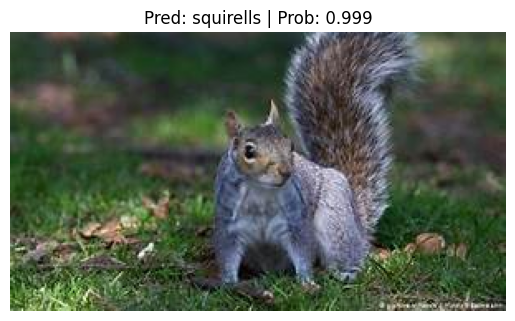

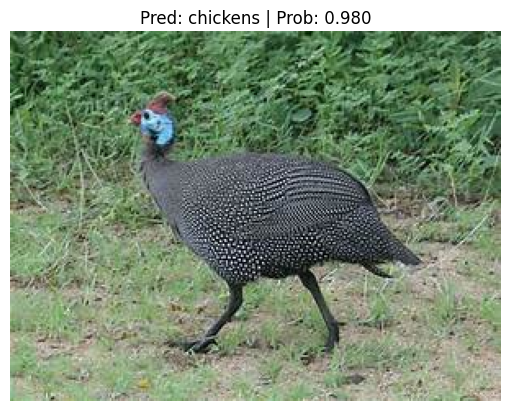

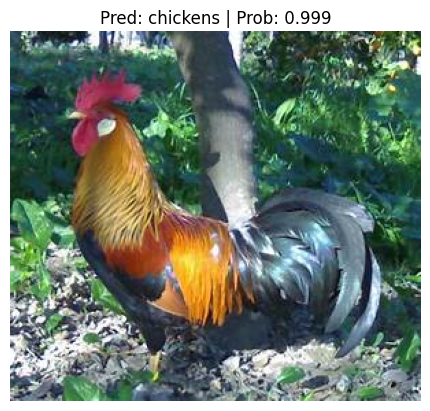

In [ ]:
import random
random_list=random.sample(list(((Path("/content/data_set40%/test").glob("*/*.jpeg")))),k=3)
random_list

for i in random_list:
  pred_and_plot_image(
      best_model,
      class_names,
      i)

Use the model where there is not transfer learning:

In [ ]:
from torch.utils.data import DataLoader
from torchvision import datasets,transforms
from torch.utils.data import Dataset
import random
from PIL import Image
from pathlib import Path
import requests
import zipfile
class vggmodel(nn.Module):
  def __init__(self,in_feature,hidden1,hidden2,hidden3,hidden4,hidden5,hidden6,linear1,linear2,out_feature):
    super().__init__()
    self.block_1=nn.Sequential(nn.Conv2d(in_feature,hidden1,kernel_size=3),nn.ReLU(),nn.Conv2d(hidden1,hidden2,kernel_size=3),nn.ReLU(),nn.MaxPool2d(2))
    self.block_2=nn.Sequential(nn.Conv2d(hidden2,hidden3,kernel_size=3),nn.ReLU(),nn.Conv2d(hidden3,hidden4,kernel_size=3),nn.ReLU(),nn.MaxPool2d(2))
    self.block_3=nn.Sequential(nn.Conv2d(hidden4,hidden5,kernel_size=3),nn.ReLU(),nn.Conv2d(hidden5,hidden6,kernel_size=3),nn.ReLU(),nn.MaxPool2d(2))

    self.last=nn.Sequential(nn.Flatten(),nn.Linear(14112,out_feature))

  def forward(self,x):
    return self.last(self.block_3(self.block_2(self.block_1(x))))





model_1=vggmodel(3,128,64,64,32,32,32,16,16,6)
model_1=model_1.to(device)



In [ ]:
try:
  import torchinfo
except:
  ! pip install torchinfo
  import torchinfo

from torchinfo import summary

data_transform2 = transforms.Compose([
    # Resize the images to 64x64
    transforms.Resize(size=(200, 200)),
    # Flip the images randomly on the horizontal
    transforms.TrivialAugmentWide(num_magnitude_bins=8), # p = probability of flip, 0.5 = 50% chance
    # Turn the image into a torch.Tensor
    transforms.ToTensor() # this also converts all pixel values from 0 to 255 to be between 0.0 and 1.0
])

train_loader,test_loader,class_names,class_index=data_creator(transform1=data_transform2)
train_loader,test_loader,class_names,class_index,len(train_loader),len(test_loader)
test_two=next(iter(train_loader))[0]



In [ ]:
model_1(test_two)

tensor([[ 0.0173, -0.0311,  0.0071, -0.0066, -0.0152, -0.0003],
        [ 0.0166, -0.0307,  0.0085, -0.0057, -0.0150,  0.0003],
        [ 0.0181, -0.0316,  0.0087, -0.0048, -0.0155,  0.0003],
        [ 0.0147, -0.0326,  0.0079, -0.0083, -0.0159,  0.0013],
        [ 0.0157, -0.0312,  0.0079, -0.0060, -0.0154,  0.0006],
        [ 0.0151, -0.0300,  0.0096, -0.0064, -0.0177,  0.0009],
        [ 0.0153, -0.0315,  0.0071, -0.0062, -0.0160,  0.0010],
        [ 0.0161, -0.0313,  0.0092, -0.0062, -0.0154,  0.0013],
        [ 0.0155, -0.0303,  0.0089, -0.0075, -0.0159,  0.0012],
        [ 0.0165, -0.0296,  0.0104, -0.0059, -0.0163,  0.0008],
        [ 0.0128, -0.0316,  0.0089, -0.0070, -0.0147,  0.0043],
        [ 0.0149, -0.0319,  0.0071, -0.0085, -0.0161,  0.0008],
        [ 0.0156, -0.0307,  0.0087, -0.0081, -0.0161,  0.0015],
        [ 0.0155, -0.0312,  0.0080, -0.0065, -0.0166,  0.0010],
        [ 0.0155, -0.0326,  0.0081, -0.0068, -0.0166, -0.0011],
        [ 0.0158, -0.0307,  0.0087, -0.0

In [ ]:


summary(model_1,input_size=[1,3,200,200])

Layer (type:depth-idx)                   Output Shape              Param #
vggmodel                                 [1, 6]                    --
├─Sequential: 1-1                        [1, 64, 98, 98]           --
│    └─Conv2d: 2-1                       [1, 128, 198, 198]        3,584
│    └─ReLU: 2-2                         [1, 128, 198, 198]        --
│    └─Conv2d: 2-3                       [1, 64, 196, 196]         73,792
│    └─ReLU: 2-4                         [1, 64, 196, 196]         --
│    └─MaxPool2d: 2-5                    [1, 64, 98, 98]           --
├─Sequential: 1-2                        [1, 32, 47, 47]           --
│    └─Conv2d: 2-6                       [1, 64, 96, 96]           36,928
│    └─ReLU: 2-7                         [1, 64, 96, 96]           --
│    └─Conv2d: 2-8                       [1, 32, 94, 94]           18,464
│    └─ReLU: 2-9                         [1, 32, 94, 94]           --
│    └─MaxPool2d: 2-10                   [1, 32, 47, 47]           --


Excellent, we now have double the training and testing images...

## 8. Make a prediction on your own custom image

We need to obtain an image

### Method 1(to obatin an image): to use requests.get




In [ ]:
from torchvision.transforms import v2

torch.float32


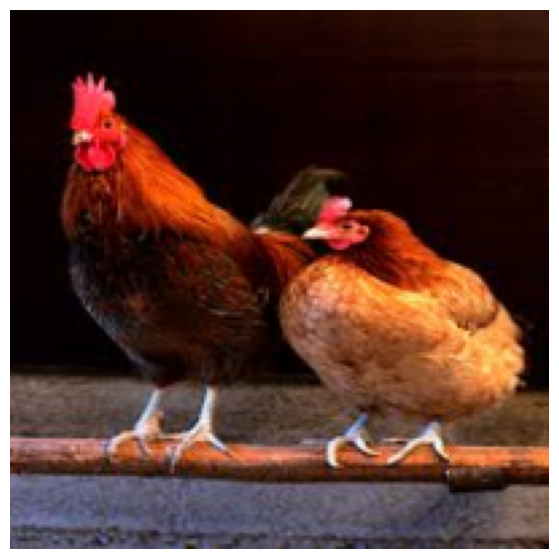

In [ ]:
predict_path=Path("new_image_path")


data_transform3 = transforms.Compose([
    # Resize the images to 64x64
    transforms.Resize(size=(200, 200)),v2.ToDtype(torch.float32, scale=True)

])

if not predict_path.is_dir():

  predict_path.mkdir(parents=True,exist_ok=True)

  with open(predict_path/"new_image.jpg", "wb") as f:
      request=requests.get("https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcR5aE9j43brqrqmRZuwLYCa4_ToQKDTfoXvaA&s")
      f.write(request.content)

import torchvision
img = data_transform3(torchvision.io.read_image(predict_path/"new_image.jpg"))
print (img.dtype)

plt.figure(figsize=(10, 7))
plt.imshow(img.permute(1, 2, 0)) # matplotlib likes images in HWC (height, width, color_channels) format not CHW (color_channels, height, width)
plt.axis(False);

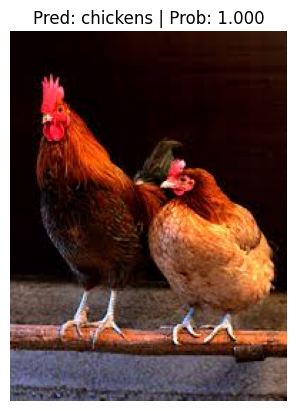

In [ ]:
pred_and_plot_image(
    best_model,
    class_names,
      Path("/content/new_image_path/new_image.jpg"))

### Method 2(to obatin an image): to use !wget



--2024-07-24 15:33:01--  https://i.natgeofe.com/k/9acd2bad-fb0e-43a8-935d-ec0aefc60c2f/monarch-butterfly-grass_3x2.jpg
Resolving i.natgeofe.com (i.natgeofe.com)... 104.97.14.201, 104.97.14.218, 2a02:26f0:6d00:c::686e:bfbf, ...
Connecting to i.natgeofe.com (i.natgeofe.com)|104.97.14.201|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 814783 (796K) [image/jpeg]
Saving to: ‘/content/new_image_path/monarch-butterfly-grass_3x2.jpg’

monarch-butterfly-g 100%[===================>] 795.69K  1007KB/s    in 0.8s    

2024-07-24 15:33:03 (1007 KB/s) - ‘/content/new_image_path/monarch-butterfly-grass_3x2.jpg’ saved [814783/814783]



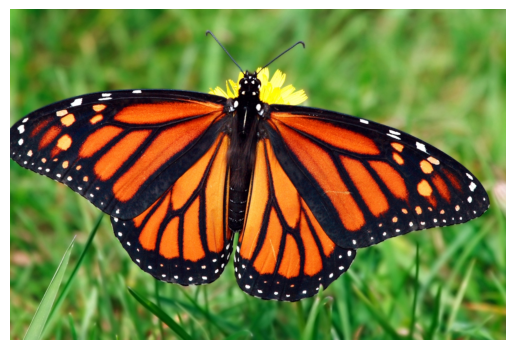

In [ ]:

!wget "https://i.natgeofe.com/k/9acd2bad-fb0e-43a8-935d-ec0aefc60c2f/monarch-butterfly-grass_3x2.jpg" -P /content/new_image_path

import matplotlib.pyplot as plt
import matplotlib.image as mpimg


img = mpimg.imread("/content/new_image_path/monarch-butterfly-grass_3x2.jpg")
#img=torchvision.io.read_image("new_image_path/monarch-butterfly-grass_3x2.jpg")
plt.imshow(img)
plt.axis('off')
plt.show()


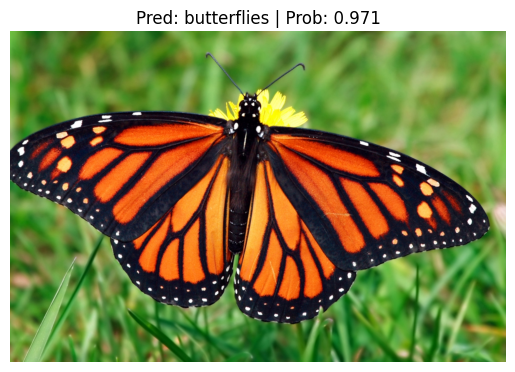

In [ ]:
pred_and_plot_image(
    best_model,
    class_names,
      Path("/content/new_image_path/monarch-butterfly-grass_3x2.jpg"))